# NYC Noise Complaints Visualization Project

## Part 1: Finding Data

The dataset contains information about NYC noise complaints and is available here: https://data.cityofnewyork.us/Social-Services/Noise-Complaints-in-2017-/be8n-q3nj

Let's first import and clean the data. I was having performance issues with the whole dataset so randomly sampled it down to a quarter of the initial size. 

In [1]:
import pandas as pd
import numpy as np
import altair as alt
import geopandas as gpd
from vega_datasets import data
import datetime
import pickle
import pprint

In [2]:
alt.renderers.enable('mimetype')

RendererRegistry.enable('mimetype')

In [2]:
noise_data = pd.read_csv("Noise_Complaints__in_2017_.csv")

C:\Users\Andrew\AppData\Local\Temp\ipykernel_31816\3106829442.py:1: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  noise_data = pd.read_csv("Noise_Complaints__in_2017_.csv")


In [4]:
# noise_data.info()

In [6]:
cleaned_noise_data = noise_data.drop(["Landmark",
                                      "Status",
                                      "Vehicle Type", 
                                      "Taxi Company Borough", 
                                      "Taxi Pick Up Location", 
                                      "Bridge Highway Name", 
                                      "Bridge Highway Direction", 
                                      "Road Ramp", 
                                      "Bridge Highway Segment", 
                                      "Location", 
                                      "Park Facility Name", 
                                      "BBL",
                                      "X Coordinate (State Plane)", 
                                      "Y Coordinate (State Plane)", 
                                      "Open Data Channel Type"], axis = 1)
# cleaned_noise_data.info()

In [7]:
dtypes= {
    "Unique Key": 'int64',
    "Created Date": 'string',
    "Closed Date": 'string',
    "Agency": 'string', 
    "Agency Name": 'string',
    "Complaint Type": 'string', 
    "Descriptor": 'string',
    "Location Type": 'string',
    "Incident Zip": 'int64',
    "Incident Address": 'string', 
    "Street Name": 'string',
    "Cross Street 1": 'string', 
    "Cross Street 2": 'string', 
    "Intersection Street 1": 'string', 
    "Intersection Street 2": 'string', 
    "Address Type": 'string', 
    "City": 'string', 
    "Facility Type": 'string', 
    "Due Date": 'string', 
    "Resolution Description": 'string', 
    "Resolution Action Updated Date": 'string', 
    "Community Board": 'string', 
    "Borough": 'string', 
    "Park Borough": 'string', 
    "Latitude": 'float64',
    "Longitude": 'float64'
}
cleaned_noise_data = cleaned_noise_data.astype(dtypes, errors='ignore')

In [30]:
# 01/01/2017 12:02:54 AM
cleaned_noise_data['Created Date'] = pd.to_datetime(cleaned_noise_data['Created Date'], format='%m/%d/%Y %I:%M:%S %p')
cleaned_noise_data['Closed Date'] = pd.to_datetime(cleaned_noise_data['Closed Date'], format='%m/%d/%Y %I:%M:%S %p')
cleaned_noise_data['Due Date'] = pd.to_datetime(cleaned_noise_data['Due Date'], format='%m/%d/%Y %I:%M:%S %p')
cleaned_noise_data['Resolution Action Updated Date'] = pd.to_datetime(cleaned_noise_data['Resolution Action Updated Date'], format='%m/%d/%Y %I:%M:%S %p')

In [31]:
cleaned_noise_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 446243 entries, 0 to 446242
Data columns (total 26 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   Unique Key                      446243 non-null  int64         
 1   Created Date                    446243 non-null  datetime64[ns]
 2   Closed Date                     444478 non-null  datetime64[ns]
 3   Agency                          446243 non-null  string        
 4   Agency Name                     446243 non-null  string        
 5   Complaint Type                  446243 non-null  string        
 6   Descriptor                      446243 non-null  string        
 7   Location Type                   386122 non-null  string        
 8   Incident Zip                    444762 non-null  float64       
 9   Incident Address                395762 non-null  string        
 10  Street Name                     395762 non-null  string 

In [32]:
cleaned_noise_data['City'] = cleaned_noise_data['City'].str.title()

In [ ]:
# cleaned_noise_data.to_pickle("noise_data.pkl")

In [33]:
# cleaned_noise_data = pd.read_pickle("noise_data.pkl")
# print(cleaned_noise_data.shape)
sampled_cleaned_noise_data = cleaned_noise_data.sample(frac=0.125, random_state=12345)
sampled_cleaned_noise_data.to_pickle("sampled_noise_data_8th.pkl")

In [3]:
sampled_cleaned_noise_data = pd.read_pickle("sampled_noise_data.pkl")
# sampled_cleaned_noise_data.shape
sampled_cleaned_noise_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 111561 entries, 389192 to 185886
Data columns (total 26 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   Unique Key                      111561 non-null  int64         
 1   Created Date                    111561 non-null  datetime64[ns]
 2   Closed Date                     111135 non-null  datetime64[ns]
 3   Agency                          111561 non-null  string        
 4   Agency Name                     111561 non-null  string        
 5   Complaint Type                  111561 non-null  string        
 6   Descriptor                      111561 non-null  string        
 7   Location Type                   96629 non-null   string        
 8   Incident Zip                    111175 non-null  float64       
 9   Incident Address                98918 non-null   string        
 10  Street Name                     98918 non-null   string 

After cleaning, the dataset has 111561 entries (randomly sampled from 446243 initially) and 27 variables. 

### Initial Questions and Goals

The dataset contains info about noise complaints in NYC. Here are my initial questions:
- **Question 1** How do overall noise complaints in each borough compare? 
- **Question 2** How does the complaint type distribution compare across boroughs?
- **Question 3** How do complaint descriptions compare across time of day?
- **Question 4** How do complaint descriptions compare across days of the week?
- **Question 5** What does the geographical distrubution look like? Can I make this into an interactive map?

### Previous Work/Inspiration
- For **Question 1** I think a simple bar chart or pie chart would work.<br>
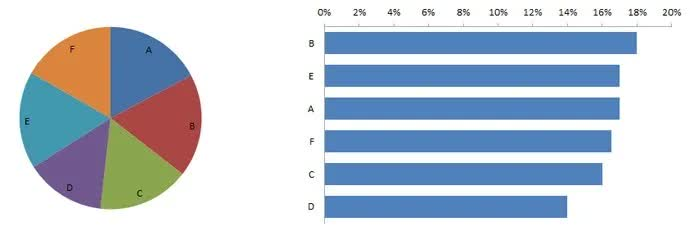
    - The bar chart might show the invididual differences better
- For **Question 2** I will try a stacked bar chart like this:<br>
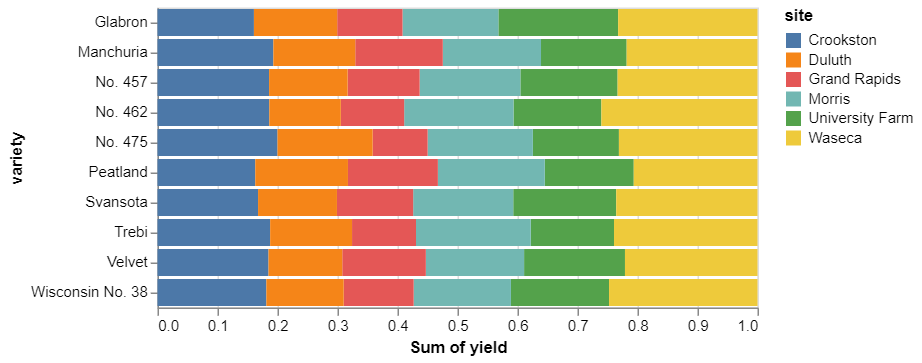
    - It's normalized, which shows the relative distribution better even if the sites had different totals
- For **Question 3** a multi-line graph should work.<br>
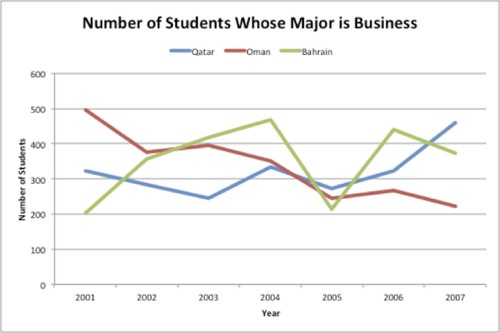
    - It shows the different time series of different groups all at once
- For **Question 4** a stacked line graph or bar graph should work.<br>
<!-- ![stacked bar](stacked-bar-chart.png "Stacked Bar Chart") -->
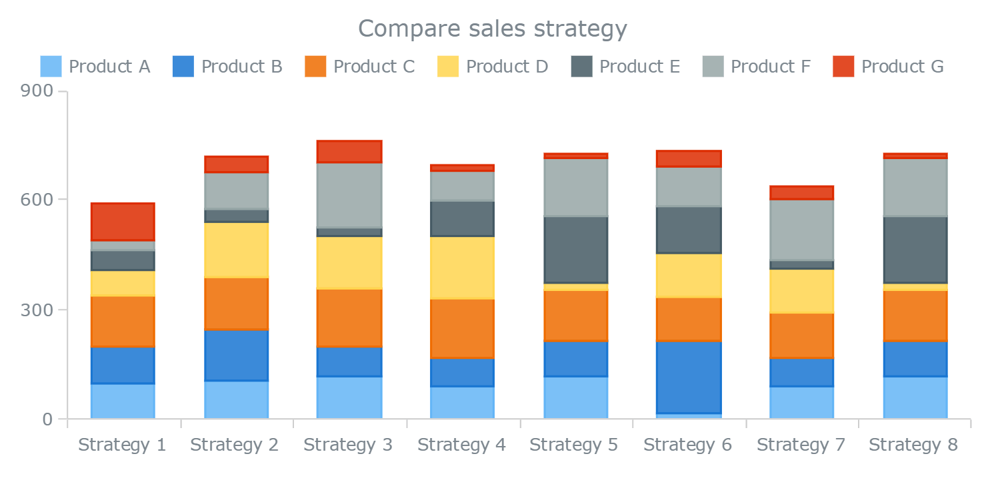
    - It shows the count and the distributions at the same time
- For **Question 5**, I want to do something showing data points across geography using the latitude and longitude. Something like this:<br>
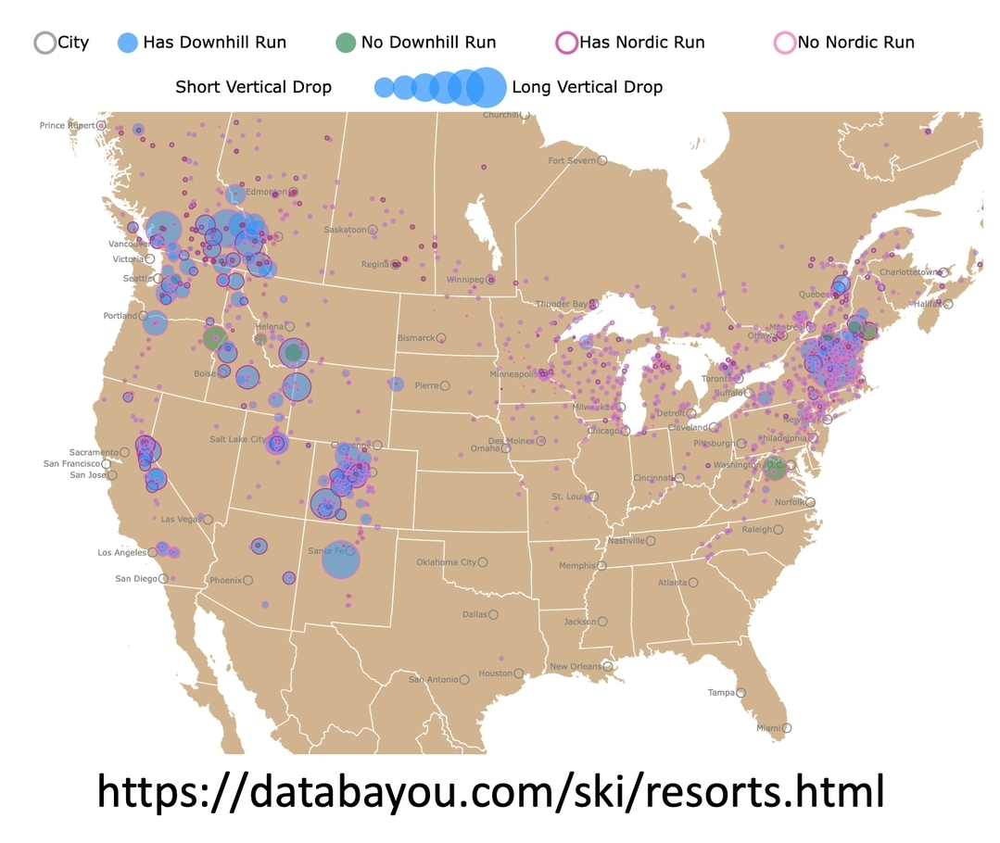
    - I like how it shows the map underneath the data points
    - Size is used to encode vertical distance, but I don't see a quantitative variable like that in my dataset (e.g. something like severity would be nice)

## Part 2: Sketching

**Question 1 & Question 2**: 
- Goal
    - To present how noise complaints vary across borough
    - To present how noise complaint types vary across borough
- Means
    - The data is organized by group. Users will see a chart showing the grouped (count) data
- Characteristics
    - High-level characteristics: counts of noise complaints in each borough, either in total or split by complaint type
- Target Data
    - Relative reference frame: group counts are compared to each other. 
- Workflow
    - One of the first tasks to be done
- Roles
    - Done by analyst to present to audience/supervisor early on

**Question 3 & Question 4**: 
- Goal
    - To present how noise complaints vary across hour/day
        - both total amount and complaint type
- Means
    - The data is organized by group. Users will see a chart showing the grouped (count) data
- Characteristics
    - High-level characteristics: counts of noise complaints by hour/day, split by complaint type
- Target Data
    - Relative reference frame: time counts are compared to each other. 
- Workflow
    - One of the intermediate stage tasks; is digging a little deeper than first task
- Roles
    - Done by analyst to present to audience/supervisor in intermediate stages
 
**Question 5**: 
- Goal
    - To present the geographic distribution of different complaints
- Means
    - The individual data points are plotted on a map and coloured according to the complaint type
- Characteristics
    - Low-level characteristics: latitude/longitude of each complaint, complaint type
- Target Data
    - Absolute reference frame: points are compared to baseline (no noise complaint). 
- Workflow
    - One of the latter tasks to be done
- Roles
    - Done by analyst to present to audience/supervisor at late/final stages
 
### Prototypes
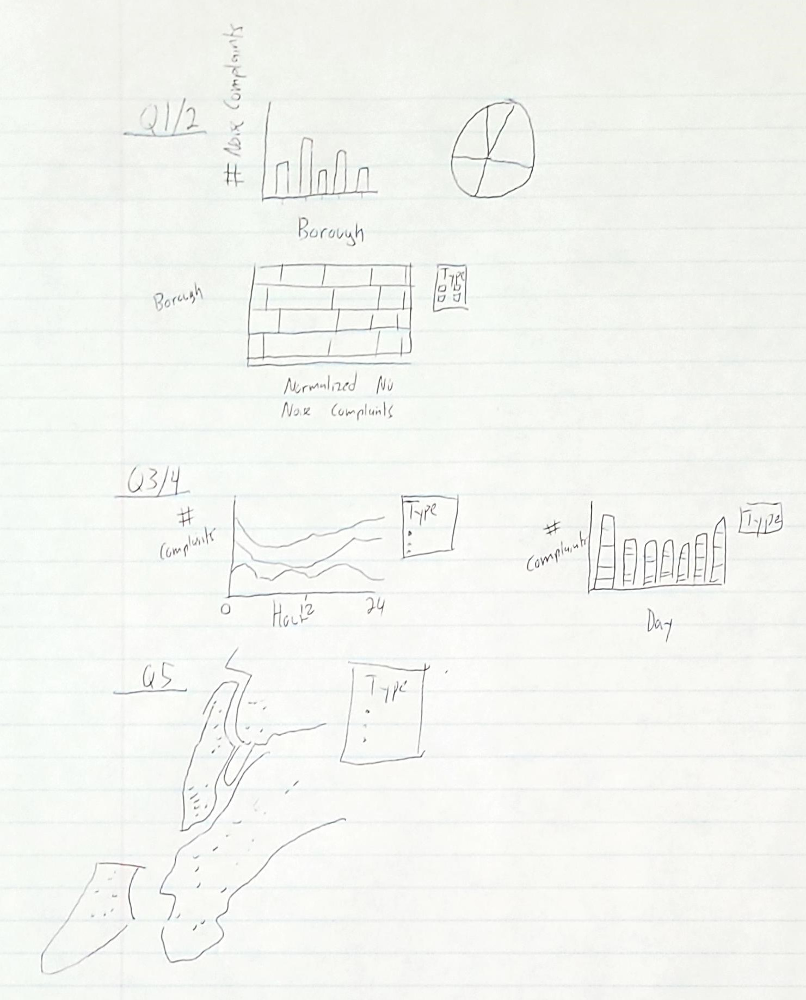

## Part 3: Evaluation

### Question 1: Borough Distribution

What does the total number of noise complaints across all boroughs look like?

In [ ]:
alt.data_transformers.disable_max_rows()
alt.Chart(sampled_cleaned_noise_data).transform_aggregate(
    count='count()',
    groupby=['Borough']
).transform_filter(
    {'not': alt.FieldEqualPredicate(field='Borough', equal='Unspecified')}
).mark_bar().encode(
    x='Borough:N',
    y=alt.Y('count:Q', title='Number of Noise Complaints'),
    color='Borough:N',
    # tooltip='count(Unique Key)',
).properties(width=400)


In [ ]:
alt.Chart(sampled_cleaned_noise_data).transform_aggregate(
    count='count()',
    groupby=['Borough']
).transform_filter(
    {'not': alt.FieldEqualPredicate(field='Borough', equal='Unspecified')}
).mark_arc().encode(
    theta=alt.Theta(field='count', type='quantitative'),
    color=alt.Color(field='Borough', type='nominal')
)


### Question 2: Complaint Type Distribution Across Borough

Is the distribution of complaint types consistent across boroughs? Note: due to out-of-memory issues the tooltip isn't working but normally there would be one with the value of that rectangle.

In [ ]:
alt.Chart(sampled_cleaned_noise_data).transform_filter(
    {'not': alt.FieldEqualPredicate(field='Borough', equal='Unspecified')}
).mark_bar().encode(
    y='Borough:N',
    x=alt.X('count()', title='Normalized Number of Noise Complaints', stack="normalize"),
    color='Complaint Type',
    tooltip=['count(Unique Key)', 'Complaint Type']
).properties(width=600, height = 300)

### Question 3: Hourly Distribution

In [ ]:
alt.Chart(sampled_cleaned_noise_data).mark_area().encode(
    x=alt.X("hours(Created Date):T", title='Hour'),
    y=alt.Y("count():Q", title='Number of Noise Complaints'),
    color="Descriptor:N"
).properties(width=600, height = 400)

Initially I had this as a line graph, but switched to a stacked area graph that shows the distribution and time of day better. 

### Question 4: Daily Distribution

In [ ]:
alt.Chart(sampled_cleaned_noise_data).mark_bar().encode(
    y=alt.Y('count()', title='Number of Noise Complaints'),
    x=alt.X('day(Created Date):O', title='Day'),
    color='Descriptor:N'
).properties(width=600, height = 500)

I first had this as normalized, but switched to unnormalized because it shows the volume of complaints across days as well as the distribution, which is more information. 

### Question 5: Geographic Distribution

Hover to see details of a specific point and select a region on the bottom to narrow down the time range

In [4]:
alt.data_transformers.disable_max_rows()

# nyc_boroughs_url = 'https://raw.githubusercontent.com/nychealth/coronavirus-data/master/Geography-resources/UHF_resources/UHF42.geo.json'
nyc_boroughs_url = 'https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/new-york-city-boroughs.geojson'
nyc_boroughs_data = alt.Data(url=nyc_boroughs_url, format=alt.DataFormat(property='features',type='json'))

gdf = gpd.read_file(nyc_boroughs_url)

# set projection and reproject
gdf = gdf.to_crs(epsg=4326)


# define inline geojson data object
# data_geojson = alt.InlineData(values=gdf.to_json(), format=alt.DataFormat(property='features',type='json')) 
# data_geojson = alt.InlineData(values=gdf, format=alt.DataFormat(property='features',type='json')) 
data_geojson = gpd.GeoDataFrame(gdf)

# complaint type
types = sampled_cleaned_noise_data.Descriptor.unique()
type_dropdown = alt.binding_select(options=[None] + list(types), labels = ['All'] + list(types))
type_select = alt.selection_point(fields=['Descriptor'], bind=type_dropdown, name="Type")

background = alt.Chart(data_geojson).mark_geoshape(
    fill='lightgray',
    stroke='white'
).properties(
    width=800,
    height=1000
)

select_date = alt.selection_interval(encodings=['x'])

trimmed_data = sampled_cleaned_noise_data[["Descriptor", "Created Date", "Latitude", "Longitude"]]

points = alt.Chart(trimmed_data).mark_circle(
    size=15
).encode(
    longitude='Longitude:Q',
    latitude='Latitude:Q',
    color=alt.Color('Descriptor:N'),
#     opacity=alt.condition((type_select & select_date), alt.value(1.0), alt.value(0.1)),
    tooltip=['Descriptor:N', "Created Date:T", "Latitude:Q", "Longitude:Q", "Borough:N"]
).project(
    type='albersUsa'
).add_params(
    type_select
).transform_filter(
    type_select
).transform_filter(
    select_date
).properties(
    width=800,
    height=1000
)

bar_slider = alt.Chart(trimmed_data).mark_bar().encode(
    x=alt.X('yearmonthdate(Created Date):T'),
    y='count()'
).add_params(
    select_date
).properties(width=800, height=50)

# background
# background + points
nyc_complaints_chart = (background + points) & bar_slider
nyc_complaints_chart
# nyc_complaints_chart.save("nyc_noise_complaints.html")


<VegaLite 5 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/display_frontends.html#troubleshooting


## Evaluation
I sent the visualizations to some peers for feedback. Their responses are below. 
1) For Q1, is the bar chart or pie chart better?<br>
    - I personally like bar charts; makes it easier to compare quantities (however less technical ppl typicaly prefer a pie chart...)
    - I like the bar chart. A bit subjective, but it’s easy to clearly see relative differences in # of complains
2) For Q2, what information do you get out of the image?<br>
    - The distribution of complaints is similar between areas/districts; howevere there is a variation in the number of complaints for each type.(would it be possible to provide a rough % highlight/header for each colour?)
    - That most noise is residential
3) Q3 and Q4 show complaints over time or day. Q3 is a stacked line graph whereas Q4 is a stacked bar graph. Is this difference intuitive?<br>
    - Yes, I like how Q3 easily shows the complaints over time where-as Q4 shows the complaints versus day.
    - It is generally clear. At first glance, without looking at the chart labels (hour vs day), it almost looks like the same data.
4) For Q5, is this an appealing interactive visualization showing noise complaints over time?<br>
    - It is interesting and I can draw some conclusions from the data (suspected airports, parks/green spaces, and high density areas) The only other thing which I might request to make it more interactive or intuitive would be to provide an option to view by each category and provide shading for higher concentrations (that way a person would be able to see noise complaints density by complaint type - however this would require a TON more work for minimal additional info. Right now you get a density map with all of that info, just, y'know, always wanting to ask for more)
    - Yes, I like the visual representation. Seems to be a good high-level view that could be extended according to Schneidermans’s Mantra (this is the overview, then next steps would be to add zoom and filtering, good use of tooltips for details on demand). My only other comment is that the colours between “Loud Music/Party” and “Noise: Boat (Engine, Music, Etc.)” are similar (and other colours may clash too). It’d be more work, but maybe adding a hover effect where all items of a given category get outlined on the map when one is hovered.

## Conclusion
- For Question 1, the bar chart was the better option to show the overall number of noise complaints across boroughs. 
- For Question 2, using normalization worked to show the distribution across boroughs and we already know the difference in total noise complaints from question 1
- For Question 3/4 the charts seemed to do a good job showing the composition and overall amount across time periods with days being discrete and time being continuous
- For Question 5, a dropdown menu was added to show the geographic distribution for a specific type of noise complaint, as well as all of them at once. Adding zooming and panning would be nice but it isn't currently supported for geographic plots in Altair. 